In [1]:
#@title Some Setup and Tool Functions
%%capture

!apt install libasound2-dev portaudio19-dev libportaudio2 libportaudiocpp0 ffmpeg
!pip install pyaudio
import io
import os
import zipfile
import requests
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import pyaudio
import wave
import base64
import soundfile as sf
from scipy.fft import fft, fftfreq
from scipy.signal import find_peaks
from scipy.io.wavfile import write
from IPython.display import display, Audio, HTML

# Tool Functions

# Plotting Functions
def initialize_plot(title="Title", xlabel="X", ylabel="Y", figsize=(10, 4)):
    plt.figure(figsize=figsize)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.gca().xaxis.set_major_locator(MultipleLocator(500))
    plt.grid(True)

def plot_signal(x, y, title="Title", xlabel="X", ylabel="Y"):
    initialize_plot(title, xlabel, ylabel)
    plt.plot(x, y)
    plt.show()

def plot_multi_signals(data_pairs, title=""):
    num_plots = len(data_pairs)
    plt.figure(figsize=(5 * num_plots, 4))

    for i, (x, y, plot_title, xlabel, ylabel) in enumerate(data_pairs, start=1):
        plt.subplot(1, num_plots, i)
        plt.plot(x, y)
        plt.title(plot_title)
        plt.xlabel(xlabel)
        plt.ylabel(ylabel)
        plt.grid(True)

    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

def plot_frequency_spectrum_with_harmonics(frequencies, spectrum, peak_freqs=None, peak_magnitudes=None,
                                           title="Frequency Spectrum with Harmonics", xlabel="Frequency (Hz)", ylabel="Magnitude",
                                           xlim=None, show=True):
    initialize_plot(title, xlabel, ylabel, figsize=(15, 4))
    plt.plot(frequencies, spectrum, label='Spectrum')
    if peak_freqs is not None and peak_magnitudes is not None:
        plt.plot(peak_freqs, peak_magnitudes, 'x', label='Harmonics')
    plt.legend()

    if xlim is not None:
        plt.xlim(xlim)

    if show:
        plt.show()

def save_plot_as_base64(width=1200, bbox_inches='tight'):  # bbox_inches='tight': rm excess margins around the plot
    buf = io.BytesIO()
    plt.savefig(buf, format="png", bbox_inches=bbox_inches)
    plt.close('all')
    buf.seek(0)
    img_base64 = base64.b64encode(buf.read()).decode("utf-8")
    return img_base64

# Html Components
def audio_html(file_path):
  if not file_path or not os.path.exists(file_path):
    return None

  return f"{Audio(file_path)._repr_html_()}"

def audio_and_harmonics_html(audio_path, peaks):
    harmonics_html = "<h4>Harmonics:</h4>" + "".join(
        f"<div>[{i}] Frequency = {freq:.2f} Hz, Amplitude = {mag:.2f}</div>"
        for i, (freq, mag) in enumerate(peaks)
    )

    html_output = f"""
      <div style="font-size: 14px; text-align: left;">
          {audio_html(audio_path)}
          {harmonics_html}
      </div>
    """
    return html_output


def base64_img_html(img_base64, width=500):
    return f"<img src='data:image/png;base64,{img_base64}' width='{width}'>"

# mode: display, save_img_base64
def plot_frequency_spectrum_with_peaks(file_path, recipe, title_prefix="", xlim=None, mode='display'):
    frequencies = recipe['frequencies']
    amplitude_spectrum = recipe['amplitude_spectrum']
    peaks = recipe['peaks']
    peak_xs, peak_ys = zip(*peaks) if peaks else ([], [])

    plot_frequency_spectrum_with_harmonics(frequencies, amplitude_spectrum, peak_xs, peak_ys, title=f"{title_prefix} Frequency Spectrum with Harmonics",
                                            xlabel="Frequency (Hz)", ylabel="Amplitude", xlim=xlim, show=False)


    img_base64 = save_plot_as_base64()

    if mode == 'save_img_base64':
      return img_base64


    html_output = f"""
    <div style="display: flex; align-items: center; white-space: nowrap; margin-bottom: 30px">
        <div style="margin-right: 50px">
            {base64_img_html(img_base64, width=1200)}
        </div>
        <div style="font-size: 14px; text-align: left;">
            {audio_and_harmonics_html(file_path, peaks)}
        </div>
    </div>
    """
    if mode == 'display':
      display(HTML(html_output))

    if mode == 'html':
      return html_output

# Others
def print_bold(content, newline=False):
    end_char = '\n' if newline else ''
    print(f'\033[1m{content}\033[0m', end=end_char)

def print_title_and_content(title, content, after_content='\n', newline=True):
    print_bold(title, newline)
    print(content, after_content)


# 【 Setting up 】

def unzip_all_zips_in_path(path):
    zip_files = [f for f in os.listdir(path) if f.endswith('.zip')]

    for zip_file in zip_files:
        zip_path = os.path.join(path, zip_file)
        folder_name = zip_file.replace('.zip', '')
        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            zip_ref.extractall(path)

def get_synthesized_auido_path(instrument, note):
    path = f"/content/synthesized_{instrument}/{note}.wav"
    return path if os.path.exists(path) else None

def get_synthesized_auido_paths(instruments, notes):
    real_audio_paths = {
        instrument: {note: f"/content/real_{instrument}/{note}.wav" for note in notes}
        for instrument in instruments
    }

    synthesized_audio_paths = {
        instrument: {
          note: get_synthesized_auido_path(instrument, note)
          for note in notes
        }
        for instrument in instruments
    }
    print('real_audio_paths:',real_audio_paths)
    print('synthesized_audio_paths:',synthesized_audio_paths)
    return real_audio_paths, synthesized_audio_paths


def synthesize_individual_tones_html(audios_obj, recipes, instrument, note):
    synthesized_audio_path = audios_obj['synthesized_audio_path']
    synthesized_recipe = get_audio_recipe(synthesized_audio_path)
    synthesized_audio_img = plot_frequency_spectrum_with_peaks(synthesized_audio_path, synthesized_recipe, title_prefix=f"Synthesized {instrument}-{note}", xlim=(0, 3000), mode='save_img_base64')
    real_aduio_recipe = recipes[instrument][note]
    real_audio_img = plot_frequency_spectrum_with_peaks(real_aduio_recipe['audio_path'], real_aduio_recipe['recipe'], title_prefix=f"Real {instrument}-{note}", xlim=(0, 3000), mode='save_img_base64')

    # print(audios_obj)
    return f"""
    <div style='margin: 0 20px 0 20px'>
      <h3 style='text-align: center;'>{instrument.capitalize()}-{note.capitalize()}</h3>
      <h4>Individual tones:</h4>
      <div>{''.join(f'''
            <div style='display: flex;'>
              {audio_html(tone['path'])}
              <div style='display: flex; margin-left: 10px'>
                <h4 style='margin-right: 10px'>{tone['freq']:.2f} Hz</h4>
                <h4>{tone['amp']:.2f}</h4>
              </div>
            </div>
          '''
          for tone in audios_obj['individual_tones']
      )}</div>
      <h4>Synthesized Audio:</h4>
      <div>{audio_html(synthesized_audio_path)}</div>
      <h4>Origin Audio:</h4>
      <div>{audio_html(audios_obj['origin_audio_path'])}</div>
      <h4>Synthesized Audio:</h4>
      <div>{base64_img_html(synthesized_audio_img, width=800)}</div>
      <h4>Origin Audio:</h4>
      <div>{base64_img_html(real_audio_img, width=800)}</div>
    </div>
  """


def display_recipe_matrix(recipes):
    instruments = list(recipes.keys())
    notes = list(next(iter(recipes.values())).keys())
    instruments_size = len(instruments)
    flex_basis = 100 / instruments_size

    instrument_names_html = "".join(
        f"""
          <div style='flex-basis: {flex_basis}%; text-align: center;'>
            <h3>{instrument.capitalize()}</h3>
          </div>
        """
        for instrument in instruments
    )


    def instrument_cols_html(note):
      return "".join(
        f"""
          <div style='flex-basis: {flex_basis}%; text-align: center;'>
            <h4>{note}</h4>
            <div>{base64_img_html(img_base64, width=550)}</div>"
            <div style='text-align: center; font-size: 15px;'>
              <div style='display: inline-block; text-align: left;'>
                {audio_and_harmonics_html(file_path, recipe['peaks'])}
              </div>
            </div>
          </div>
        """
        for instrument in instruments
        if (file_path := recipes[instrument][note]['audio_path']) and os.path.exists(file_path)
        if (recipe := recipes[instrument][note]['recipe'])
        if (img_base64 := plot_frequency_spectrum_with_peaks(file_path, recipe, title_prefix='', xlim=(0, 3000), mode='save_img_base64'))
    )

    note_rows_html = "".join(
        f"""<div style='display: flex; width: 100%; justify-content: center;'>
          {instrument_cols_html(note)}
        </div>"""
        for note in notes
    )

    margin_left = f"{instruments_size * 150}px" if instruments_size > 3 else "0px"
    html_output = f"""
      <div style='margin-left: {margin_left};'>
        <div style='display: flex; width: 100%; justify-content: center; margin-bottom: 10px;'>
          {instrument_names_html}
        </div>
        <div>
          {note_rows_html}
        </div>
      </div>
    """
    display(HTML(html_output))



def filter_recipes(recipes, selected_instruments, selected_notes):
    return {
        instrument: {
            note: recipes[instrument][note]
            for note in selected_notes if note in recipes[instrument]
        }
        for instrument in selected_instruments if instrument in recipes
    }

def make_envelope(attack_time, decay_time, sustain_level, release_time, sample_rate=44100, duration=2):
    time = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
    envelope = np.zeros_like(time)

    for i, t in enumerate(time):
        if t < attack_time:
            envelope[i] = t / attack_time
        elif t < attack_time + decay_time:
            t_decay = t - attack_time
            envelope[i] = 1 - (1 - sustain_level) * (t_decay / decay_time)
        elif t < duration - release_time:
            envelope[i] = sustain_level
        else:
            t_release = t - (duration - release_time)
            envelope[i] = sustain_level * (1 - t_release / release_time)

    return time, envelope

def generate_adsr_wave(origin_wave, attack_time, decay_time, sustain_level, release_time, sample_rate, duration, filename=None):
    time, envelope = make_envelope(attack_time, decay_time, sustain_level, release_time, sample_rate, duration)
    adsr_wave = origin_wave * envelope

    if filename:
        write(filename, sample_rate, (adsr_wave * 32767).astype(np.int16))
        display(Audio(filename))

    plt.figure(figsize=(10, 3))
    plt.plot(time, envelope, label="ADSR Envelope", color="blue")
    plt.title("ADSR Envelope", fontsize=16)
    plt.xlabel("Time (s)", fontsize=12)
    plt.ylabel("Amplitude", fontsize=12)
    plt.axvline(x=attack_time, color='red', linestyle='--', label='Attack End')
    plt.axvline(x=attack_time + decay_time, color='green', linestyle='--', label='Decay End')
    plt.axvline(x=duration - release_time, color='orange', linestyle='--', label='Sustain End')
    plt.legend()
    plt.grid()
    plt.show()

    return adsr_wave

In [2]:
#@title Prepare files
# Unzip zip files
unzip_all_zips_in_path('/content')

# Set file paths
INSTRUMENTS = ["piano", "harp"]
NOTES = ["C4", "D4", "E4"]
real_audio_paths, synthesized_audio_paths = get_synthesized_auido_paths(INSTRUMENTS, NOTES)

real_audio_paths: {'piano': {'C4': '/content/real_piano/C4.wav', 'D4': '/content/real_piano/D4.wav', 'E4': '/content/real_piano/E4.wav'}, 'harp': {'C4': '/content/real_harp/C4.wav', 'D4': '/content/real_harp/D4.wav', 'E4': '/content/real_harp/E4.wav'}}
synthesized_audio_paths: {'piano': {'C4': None, 'D4': None, 'E4': None}, 'harp': {'C4': None, 'D4': None, 'E4': None}}


In [3]:
sample_path_1 = real_audio_paths['piano']['C4']
sample_path_2 = real_audio_paths['harp']['C4']

display(Audio(sample_path_1))
display(Audio(sample_path_2))

# 音声データを分解してみまーす！

In [4]:
def get_audio_recipe_step_1(file_path, show_details=False):
  if not file_path or not os.path.exists(file_path):
    return None, None

  # データ、サンプリング周波数を読み込む
  audio, sample_rate = sf.read(file_path)
  if show_details:
    print_title_and_content('Original audio: (first 20 lines)', audio[:20])
    print_title_and_content('Audio shape: ', audio.shape)
    print_title_and_content('Sample rate: ', sample_rate)

  return audio, sample_rate

audio, sample_rate = get_audio_recipe_step_1(sample_path_1, show_details=True)

Original audio: (first 20 lines)
[[ 0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  6.10351562e-05]
 [ 1.22070312e-04  4.27246094e-04]
 [ 1.22070312e-04  4.88281250e-04]
 [ 1.22070312e-04  4.88281250e-04]
 [ 1.83105469e-04  4.88281250e-04]
 [ 1.83105469e-04  4.88281250e-04]
 [ 1.83105469e-04  5.49316406e-04]
 [ 6.10351562e-05  5.49316406e-04]
 [ 0.00000000e+00  5.49316406e-04]
 [-2.44140625e-04  3.05175781e-04]
 [-7.93457031e-04 -4.88281250e-04]
 [-1.70898438e-03 -2.31933594e-03]
 [-3.05175781e-03 -5.55419922e-03]
 [-4.82177734e-03 -1.02539062e-02]
 [-6.89697266e-03 -1.66625977e-02]
 [-9.09423828e-03 -2.51464844e-02]
 [-1.15966797e-02 -3.61633301e-02]
 [-1.49536133e-02 -5.06286621e-02]] 

Audio shape: 
(396900, 2) 

Sample rate: 
44100 



In [5]:
# 複数チャンネルの場合、各チャンネルの平均値を取って、モノラルに変換する
def get_audio_recipe_step_2(audio, show_details=False):
  if audio.ndim > 1:
      if show_details:
          # print("Maximum amplitude of the left channel:", np.max(np.abs(audio[:, 0])))
          # print("Maximum amplitude of the right channel:", np.max(np.abs(audio[:, 1])))
          print_bold('Convert multi-channel audio to mono...\n\n')
      audio = audio.mean(axis=1)
  if show_details:
      print_title_and_content('Audio:', audio, '\n')
      print_title_and_content('Audio shape:', audio.shape)
  return audio

audio = get_audio_recipe_step_2(audio, show_details=True)

Convert multi-channel audio to mono...

Audio:
[0.00000000e+00 0.00000000e+00 3.05175781e-05 ... 3.05175781e-05
 1.52587891e-05 0.00000000e+00] 

Audio shape:
(396900,) 



Spectrum complex (full size):
[-0.05545044-0.j          0.20413481+0.08875789j  0.41538886+0.1156603j
 ...  0.53601962-0.17996306j  0.41538886-0.1156603j
  0.20413481-0.08875789j] 

Spectrum complex:
[-5.54504395e-02-0.j          2.04134810e-01+0.08875789j
  4.15388855e-01+0.1156603j  ...  3.91474434e-03+0.00140411j
 -1.15925176e-02-0.00427282j -2.15939793e-04-0.00902424j] 

Amplitudes:
[0.05545044 0.22259601 0.43119045 ... 0.00415893 0.01235489 0.00902682] 

Phase:
[-3.14159265  0.41014226  0.27156025 ...  0.34437893 -2.78845881
 -1.59472062] 

Frequencies:
[0.00000000e+00 1.11111111e-01 2.22222222e-01 ... 2.20496667e+04
 2.20497778e+04 2.20498889e+04] 



/usr/local/lib/python3.11/dist-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib/python3.11/dist-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


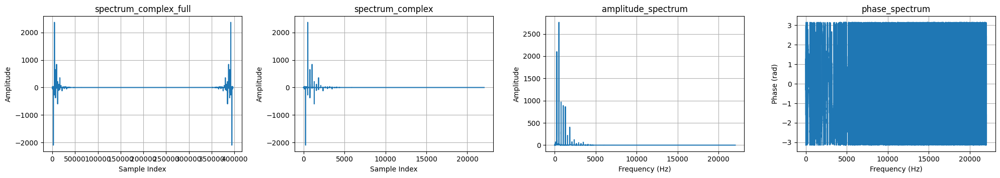

In [6]:
 # 時間領域信号を周波数領域に変換
def get_audio_recipe_step_3(audio, show_details=False):
  N = len(audio) # 音声データのサンプル数（全体の長さ）
  spectrum_complex_full = fft(audio)  # 高速フーリエ変換（FFT）を適用し、複素スペクトル(振幅と位相)を得る
  spectrum_complex = spectrum_complex_full[:N // 2]  # 正の周波数部分のみを取得 (周波数スペクトルが対称だから、正の周波数のみで十分)

  amplitude_spectrum = np.abs(spectrum_complex) # 絶対値 -> 振幅
  phase_spectrum = np.angle(spectrum_complex) # 偏角 -> 位相

  delta_t = 1 / sample_rate  # 1サンプルの時間間隔（s）
  frequencies = fftfreq(N, delta_t)[:N // 2]  # FFT結果に対応する周波数（Hz）

  if show_details:
    print_title_and_content('Spectrum complex (full size):', spectrum_complex_full)
    print_title_and_content('Spectrum complex:',  spectrum_complex)
    print_title_and_content('Amplitudes:',  amplitude_spectrum)
    # print_title_and_content('Maximum amplitudes:',  np.max(amplitude_spectrum))
    print_title_and_content('Phase:',  phase_spectrum)
    # print_title_and_content('Maximum phase:',  np.max(phase_spectrum))
    print_title_and_content('Frequencies:',  frequencies)
    # print_title_and_content('Maximum frequency:',  np.max(frequencies))

    plot_multi_signals([
        (range(len(spectrum_complex_full)), spectrum_complex_full, "spectrum_complex_full", "Sample Index", "Amplitude"),
        (frequencies, spectrum_complex, "spectrum_complex", "Sample Index", "Amplitude"),
        (frequencies, amplitude_spectrum, "amplitude_spectrum", "Frequency (Hz)", "Amplitude"),
        (frequencies, phase_spectrum, "phase_spectrum", "Frequency (Hz)", "Phase (rad)")
    ])

  return spectrum_complex, amplitude_spectrum, phase_spectrum, frequencies

spectrum_complex, amplitude_spectrum, phase_spectrum, frequencies = get_audio_recipe_step_3(audio, show_details=True)

Peak indices:
[ 2355  4661  4713  4779  7076  9446 11825 14216 16626] 

Peaks:
[(np.float64(261.66666666666663), np.float64(2100.354122259287)), (np.float64(517.8888888888889), np.float64(142.76597555356247)), (np.float64(523.6666666666666), np.float64(2759.402766184614)), (np.float64(531.0), np.float64(148.4347953142307)), (np.float64(786.2222222222222), np.float64(968.8628768549794)), (np.float64(1049.5555555555554), np.float64(888.4315054210066)), (np.float64(1313.888888888889), np.float64(863.8636775847955)), (np.float64(1579.5555555555554), np.float64(219.35241217475658)), (np.float64(1847.3333333333333), np.float64(403.53033183823794))] 



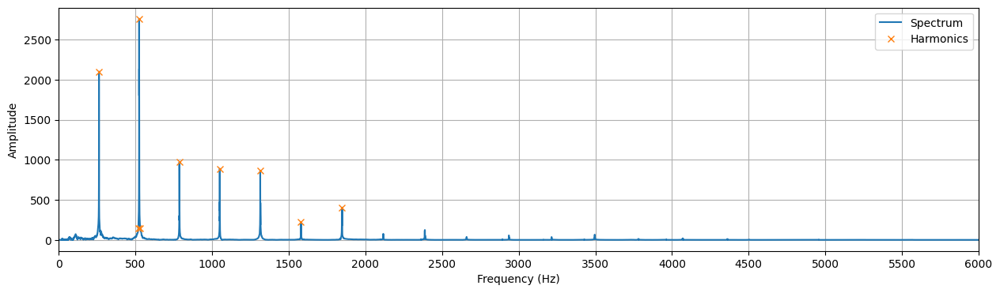

In [7]:
# ピーク（振幅が閾値を超える周波数成分）を検出
def get_audio_recipe_step_4(amplitude_spectrum, frequencies, show_details=False):
  amplitude_threshold = 0.05 * np.max(amplitude_spectrum)
  peak_indices, _ = find_peaks(amplitude_spectrum, height=amplitude_threshold, distance=20)
  peaks = [(frequencies[p], amplitude_spectrum[p]) for p in peak_indices]

  if show_details:
    print_title_and_content('Peak indices:',peak_indices)
    print_title_and_content('Peaks:',peaks)

    peak_xs, peak_ys = zip(*peaks) if peaks else ([], [])
    plot_frequency_spectrum_with_harmonics(frequencies, amplitude_spectrum, peak_xs, peak_ys, title="",
                                            xlabel="Frequency (Hz)", ylabel="Amplitude", xlim=(0, 6000), show=False)
  return peak_indices, peaks

peak_indices, peaks = get_audio_recipe_step_4(amplitude_spectrum, frequencies, show_details=True)



In [8]:
def get_audio_recipe(file_path, show_details=False):
  audio, sample_rate = get_audio_recipe_step_1(file_path)
  if audio is None:
    return None
  audio = get_audio_recipe_step_2(audio)
  spectrum_complex, amplitude_spectrum, phase_spectrum, frequencies = get_audio_recipe_step_3(audio)
  peak_indices, peaks = get_audio_recipe_step_4(amplitude_spectrum, frequencies)

  recipe = {
      'frequencies': frequencies,  # 周波数（Hz）
      'amplitude_spectrum': amplitude_spectrum,  # 振幅
      'phase_spectrum': phase_spectrum,  # 位相
      'peak_indices': peak_indices,  # ピークのインデックス
      'peaks': peaks,  # ピーク
      'sample_rate': sample_rate  # データのサンプリング周波数
  }

  return recipe

get_audio_recipe(sample_path_1, show_details=True)



{'frequencies': array([0.00000000e+00, 1.11111111e-01, 2.22222222e-01, ...,
        2.20496667e+04, 2.20497778e+04, 2.20498889e+04]),
 'amplitude_spectrum': array([0.05545044, 0.22259601, 0.43119045, ..., 0.00415893, 0.01235489,
        0.00902682]),
 'phase_spectrum': array([-3.14159265,  0.41014226,  0.27156025, ...,  0.34437893,
        -2.78845881, -1.59472062]),
 'peak_indices': array([ 2355,  4661,  4713,  4779,  7076,  9446, 11825, 14216, 16626]),
 'peaks': [(np.float64(261.66666666666663), np.float64(2100.354122259287)),
  (np.float64(517.8888888888889), np.float64(142.76597555356247)),
  (np.float64(523.6666666666666), np.float64(2759.402766184614)),
  (np.float64(531.0), np.float64(148.4347953142307)),
  (np.float64(786.2222222222222), np.float64(968.8628768549794)),
  (np.float64(1049.5555555555554), np.float64(888.4315054210066)),
  (np.float64(1313.888888888889), np.float64(863.8636775847955)),
  (np.float64(1579.5555555555554), np.float64(219.35241217475658)),
  (np.float

In [9]:
#@title 全ての音声データのレシピを取得する
def get_recipes(instruments, notes):
  return {
    instrument: {
        note: {
            'audio_path': (audio_path := real_audio_paths[instrument][note]),
            'recipe': get_audio_recipe(audio_path)
        }
        for note in notes
    }
    for instrument in instruments
  }

recipes = get_recipes(INSTRUMENTS, NOTES)
print(recipes)

{'piano': {'C4': {'audio_path': '/content/real_piano/C4.wav', 'recipe': {'frequencies': array([0.00000000e+00, 1.11111111e-01, 2.22222222e-01, ...,
       2.20496667e+04, 2.20497778e+04, 2.20498889e+04]), 'amplitude_spectrum': array([0.05545044, 0.22259601, 0.43119045, ..., 0.00415893, 0.01235489,
       0.00902682]), 'phase_spectrum': array([-3.14159265,  0.41014226,  0.27156025, ...,  0.34437893,
       -2.78845881, -1.59472062]), 'peak_indices': array([ 2355,  4661,  4713,  4779,  7076,  9446, 11825, 14216, 16626]), 'peaks': [(np.float64(261.66666666666663), np.float64(2100.354122259287)), (np.float64(517.8888888888889), np.float64(142.76597555356247)), (np.float64(523.6666666666666), np.float64(2759.402766184614)), (np.float64(531.0), np.float64(148.4347953142307)), (np.float64(786.2222222222222), np.float64(968.8628768549794)), (np.float64(1049.5555555555554), np.float64(888.4315054210066)), (np.float64(1313.888888888889), np.float64(863.8636775847955)), (np.float64(1579.555555555


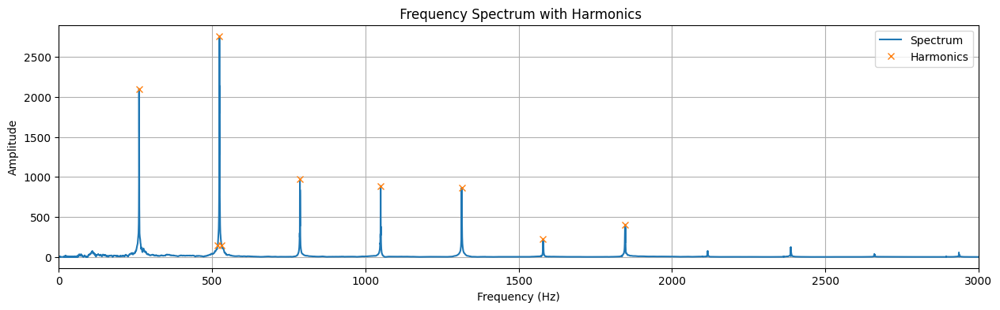
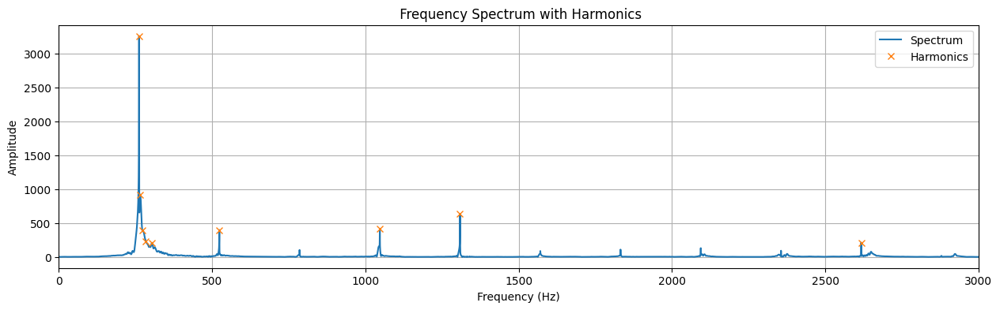
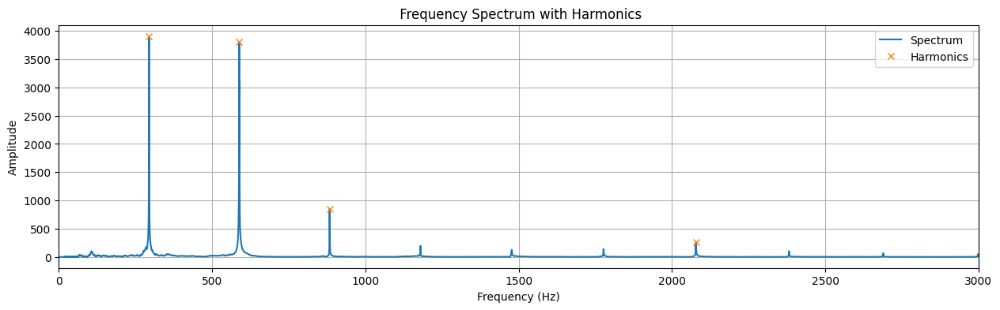
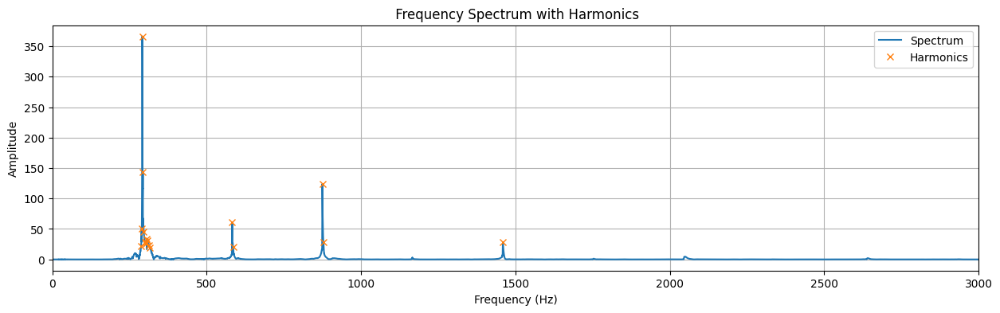
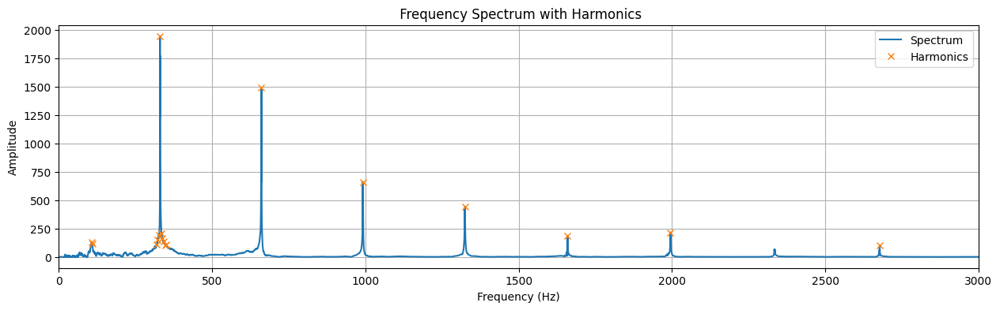
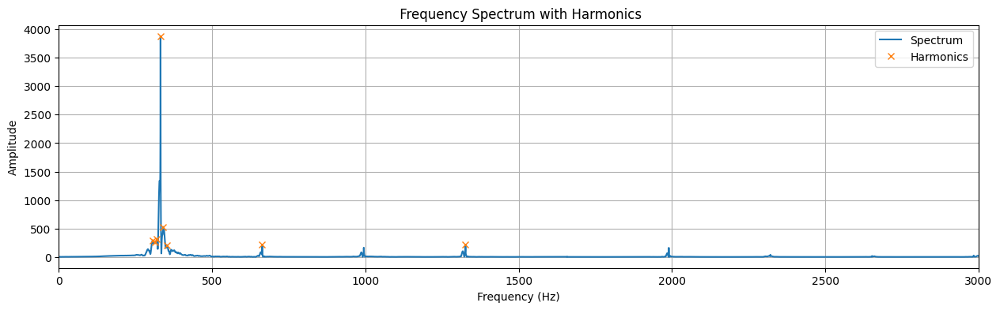

In [10]:
display_recipe_matrix(recipes)

# レシピを使って、音声を合成してみます


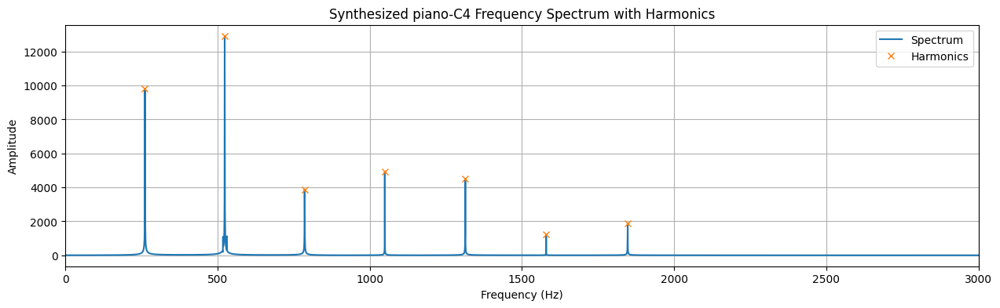
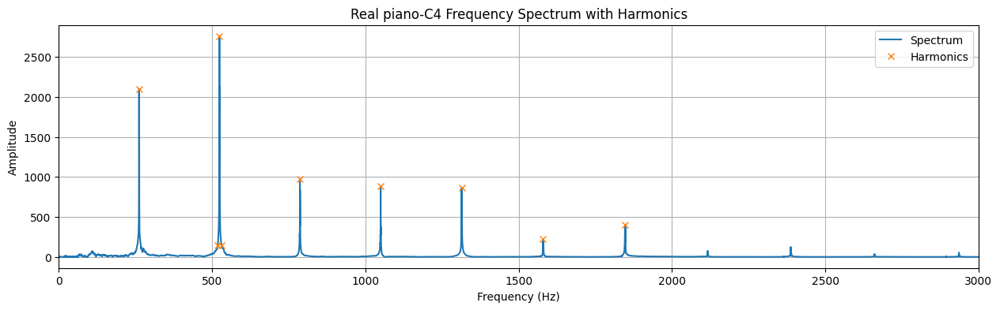
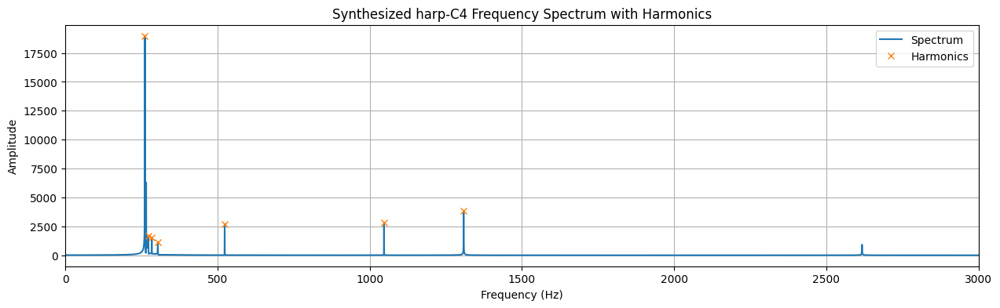
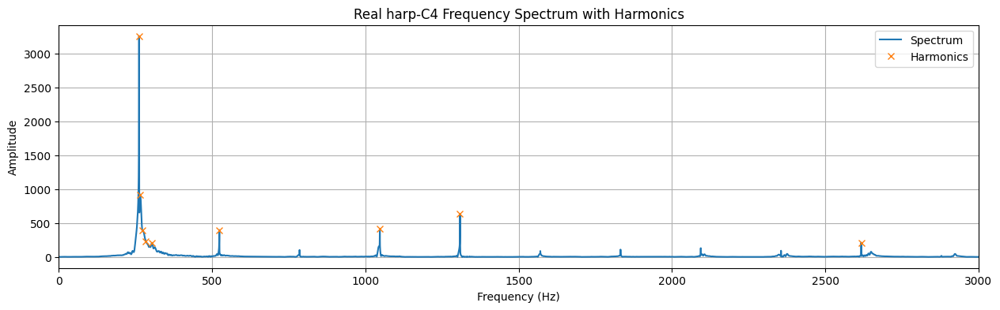

In [11]:
selected_instruments = ['piano', 'harp']
selected_notes = ['C4']


def generate_individual_tones_and_synthesized_audio(recipe_obj, instrument, duration=2):
    origin_audio_path = recipe_obj['audio_path']
    recipe = recipe_obj['recipe']
    sample_rate = recipe['sample_rate']
    frequencies = recipe['frequencies']
    amplitudes = recipe['amplitude_spectrum']
    phases = recipe['phase_spectrum']
    peak_indices = recipe['peak_indices']

    t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
    synthesized_audio = np.zeros_like(t)

    individual_tones = []
    # 各ピークの音を生成する
    for i, peak_idx in enumerate(peak_indices):
        freq = frequencies[peak_idx] # 周波数（Hz）
        amp = amplitudes[peak_idx] # 振幅
        phase = phases[peak_idx] # 位相
        tone = amp * np.sin(2 * np.pi * freq * t + phase) # 音を合成する式(正弦波の一般式)：振幅 × sin(2π × 周波数 × 時間 + 位相)
        # tone = amp * np.sin(2 * np.pi * freq * t)

        tone_filename = f'tone_{i}_freq_{int(freq)}Hz.wav'
        write(tone_filename, sample_rate, (tone * 32767).astype(np.int16))

        individual_tones.append({'path': tone_filename, 'freq': freq, 'amp': amp})
        synthesized_audio += tone # 最後の合成音に加算する

    synthesized_audio = synthesized_audio / np.max(np.abs(synthesized_audio)) # 音量を正規化する

    synthesized_filename = f'{instrument}_synthesized_sound.wav'
    write(synthesized_filename, sample_rate, (synthesized_audio * 32767).astype(np.int16))

    return {
        'origin_audio_path': origin_audio_path,
        'synthesized_audio_path': synthesized_filename,
        'individual_tones': individual_tones
    }


def display_synthesize_individual_tones(selected_instruments, selected_notes, duration = 2):
    html_blocks = []

    for note in selected_notes:
        row_blocks = []
        for instrument in selected_instruments:
            audios_obj = generate_individual_tones_and_synthesized_audio(recipes[instrument][note], instrument, duration)
            row_blocks.append(
                synthesize_individual_tones_html(audios_obj, recipes, instrument, note)
            )
        html_blocks.append(f"<div style='display: flex;'>{''.join(row_blocks)}</div>")
    html_content = "\n".join(html_blocks)
    display(HTML(html_content))

display_synthesize_individual_tones(selected_instruments, selected_notes)


# 違うパターンのADSRを掛けてみます





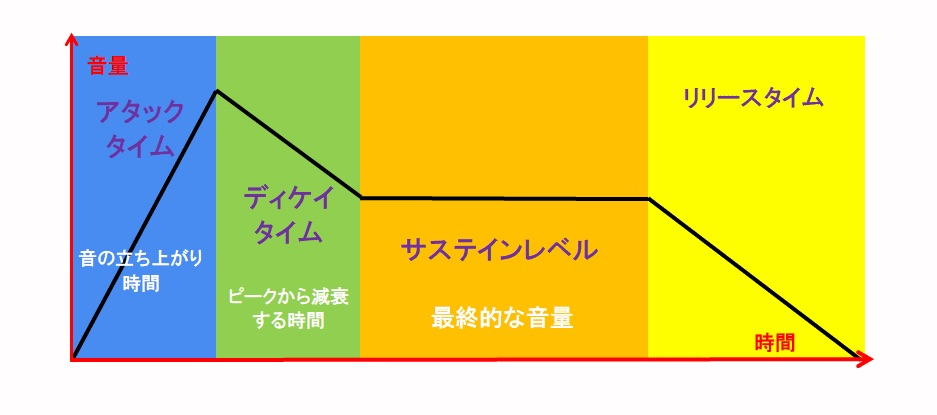

Example 1: (Attack 0.1 %, Decay 0.3 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.3) %


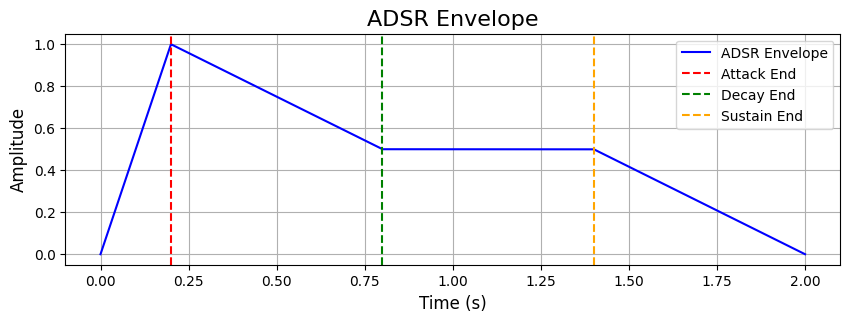

Example 2: (Attack 0.7 %, Decay 0.1 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.1) %


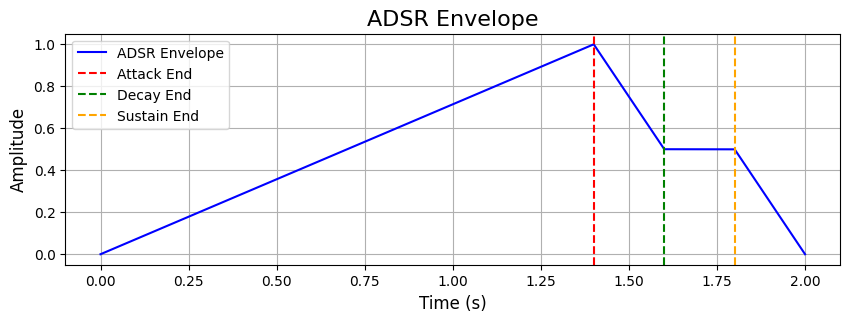

Example 3: (Attack 0.3 %, Decay 0.1 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.3) %


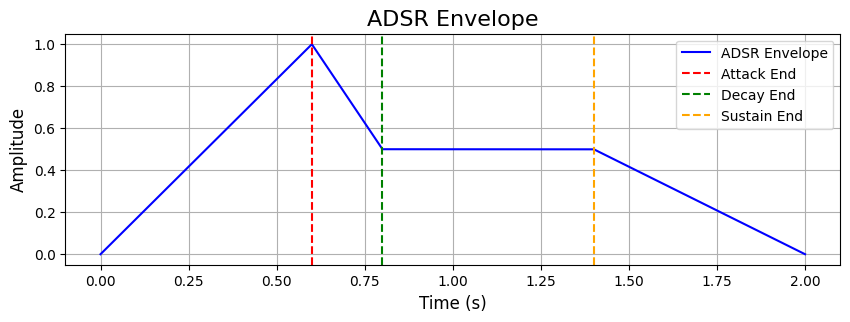

Example 4: (Attack 0.1 %, Decay 0.7 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.1) %


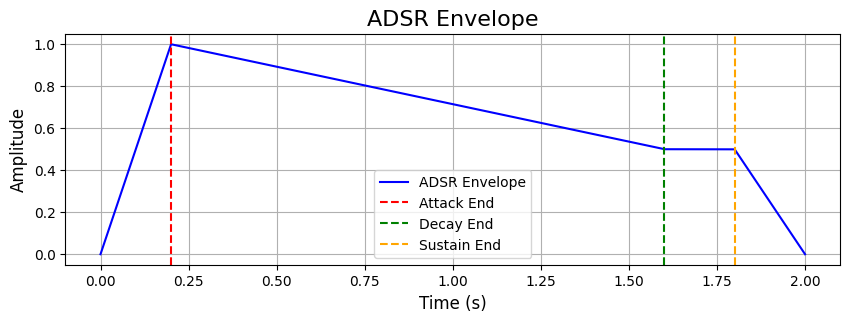

Example 5: (Attack 0.3 %, Decay 0.3 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.3) %


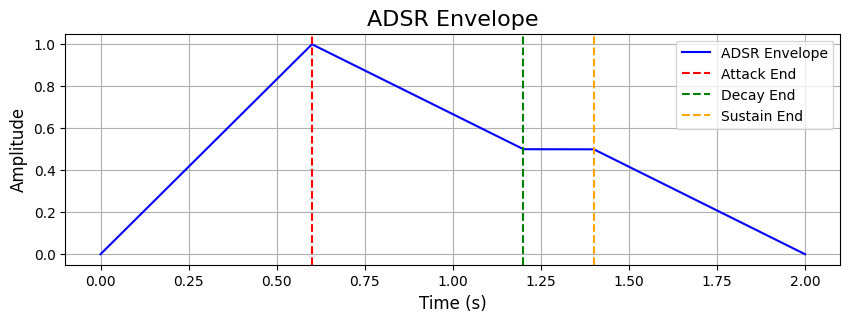

Example 6: (Attack 0.1 %, Decay 0.1 %, Sustain 0.7 % (Sustain Level 0.5), Release 0.1) %


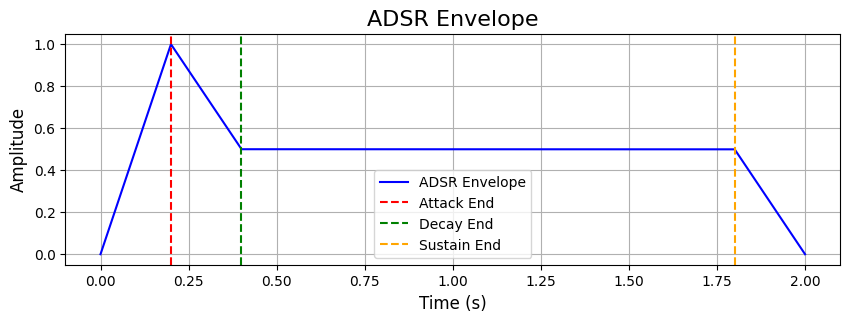

Example 7: (Attack 0.3 %, Decay 0.3 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.1) %


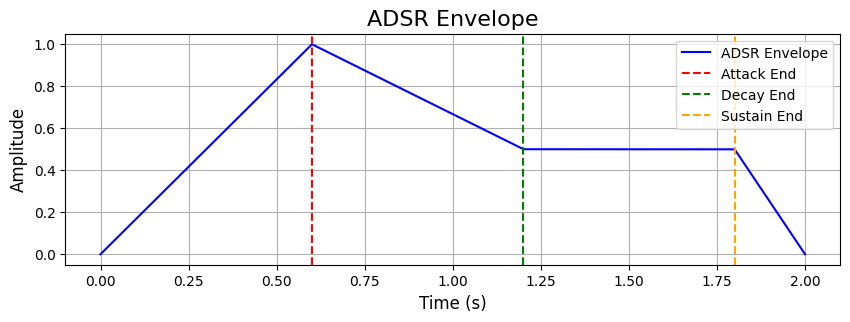

Example 8: (Attack 0.1 %, Decay 0.1 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.7) %


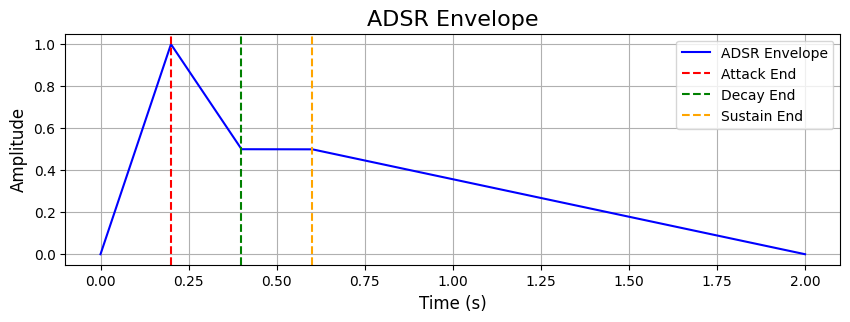

Example 9: (Attack 0.25 %, Decay 0.25 %, Sustain 0.2 % (Sustain Level 0.1), Release 0.25) %


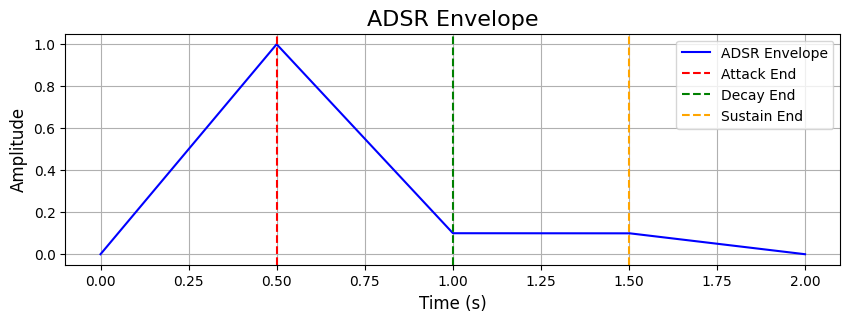

Example 10: (Attack 0.25 %, Decay 0.25 %, Sustain 0.2 % (Sustain Level 0.9), Release 0.25) %


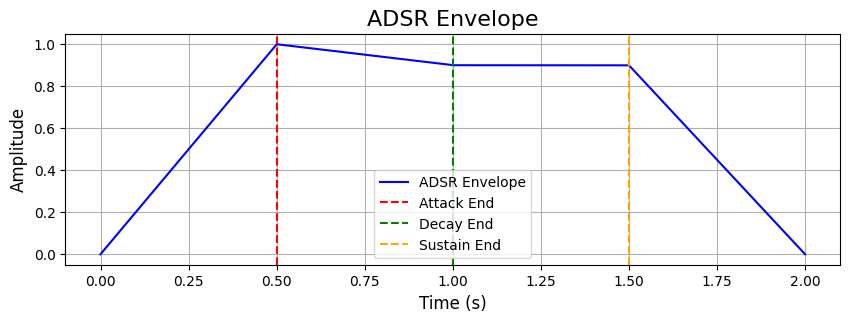

In [12]:

origin_wave, sample_rate = sf.read('/content/harp_synthesized_sound.wav')
duration = len(origin_wave) / sample_rate
time = np.linspace(0, duration, len(origin_wave), endpoint=False)

# Attack(%), Decay(%), Sustain Level(0~1. Sustain proportion = 1 - others), Release(%)
adsr_examples = [
    (0.1, 0.3, 0.5, 0.3),
    (0.7, 0.1, 0.5, 0.1),

    (0.3, 0.1, 0.5, 0.3),
    (0.1, 0.7, 0.5, 0.1),

    (0.3, 0.3, 0.5, 0.3),
    (0.1, 0.1, 0.5, 0.1),

    (0.3, 0.3, 0.5, 0.1),
    (0.1, 0.1, 0.5, 0.7),


    (0.25, 0.25, 0.1, 0.25),
    (0.25, 0.25, 0.9, 0.25),
]

for i, (attack_ratio, decay_ratio, sustain_level, release_ratio) in enumerate(adsr_examples):
    print(f"Example {i + 1}: (Attack {attack_ratio} %, Decay {decay_ratio} %, Sustain {1-attack_ratio-decay_ratio-release_ratio:.1f} % (Sustain Level {sustain_level}), Release {release_ratio}) %")
    filename = f"adsr_example_{i + 1}.wav"
    attack_time = attack_ratio * duration
    decay_time = decay_ratio * duration
    release_time = release_ratio * duration
    generate_adsr_wave(origin_wave, attack_time, decay_time, sustain_level, release_time, sample_rate, duration, filename=filename)